# Prediction of Customer Churn in Banking Sector

### Importing required libraries

In [842]:
import pandas as pd
import numpy as np

In [843]:
import statsmodels.api as sm
from statsmodels.stats.outliers_influence import variance_inflation_factor
from imblearn.over_sampling import SMOTE

In [844]:
from sklearn.feature_selection import RFE

from sklearn.model_selection import train_test_split
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV

from sklearn.preprocessing import PowerTransformer
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import SGDClassifier

from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from xgboost import XGBClassifier
import xgboost as xgb
from sklearn.metrics import roc_curve, roc_auc_score
from sklearn.metrics import classification_report, accuracy_score, confusion_matrix

In [845]:
import altair as alt
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib_venn import venn3

## Data Understanding

In [846]:
cust = pd.read_csv(r'D:\Maria\Data Files\bank_cust_churn.csv')
cust.head()

,"RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited"
0,"1,15634602,Hargrave,619,France,Female,42,2,0,1..."
1,"2,15647311,Hill,608,Spain,Female,41,1,83807.86..."
2,"3,15619304,Onio,502,France,Female,42,8,159660...."
3,"4,15701354,Boni,699,France,Female,39,1,0,2,0,0..."
4,"5,15737888,Mitchell,850,Spain,Female,43,2,1255..."


In [847]:
col_names = cust.columns.str.split(',')[0]

In [848]:
cust['val_list']=cust.iloc[:,0].str.split(',')

In [849]:
cust.columns

Index(['RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited', 'val_list'], dtype='object')

In [850]:
df = pd.DataFrame(columns=col_names)

In [851]:
col_names = list(df.columns)
col_names

['RowNumber',
 'CustomerId',
 'Surname',
 'CreditScore',
 'Geography',
 'Gender',
 'Age',
 'Tenure',
 'Balance',
 'NumOfProducts',
 'HasCrCard',
 'IsActiveMember',
 'EstimatedSalary',
 'Exited']

In [852]:
data = []
for lis in cust['val_list']:
    data.append(dict(zip(col_names,lis)))

In [853]:
len(data)

10000

In [854]:
df = df.append(data,True)

In [855]:
df.shape

(10000, 14)

In [856]:
df.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 14 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   RowNumber        10000 non-null  object
 1   CustomerId       10000 non-null  object
 2   Surname          10000 non-null  object
 3   CreditScore      10000 non-null  object
 4   Geography        10000 non-null  object
 5   Gender           10000 non-null  object
 6   Age              10000 non-null  object
 7   Tenure           10000 non-null  object
 8   Balance          10000 non-null  object
 9   NumOfProducts    10000 non-null  object
 10  HasCrCard        10000 non-null  object
 11  IsActiveMember   10000 non-null  object
 12  EstimatedSalary  10000 non-null  object
 13  Exited           10000 non-null  object
dtypes: object(14)
memory usage: 1.1+ MB


In [857]:
df.head(10)

,RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
0,1,15634602,Hargrave,619,France,Female,42,2,0,1,1,1,101348.88,1
1,2,15647311,Hill,608,Spain,Female,41,1,83807.86,1,0,1,112542.58,0
2,3,15619304,Onio,502,France,Female,42,8,159660.8,3,1,0,113931.57,1
3,4,15701354,Boni,699,France,Female,39,1,0,2,0,0,93826.63,0
4,5,15737888,Mitchell,850,Spain,Female,43,2,125510.82,1,1,1,79084.1,0
5,6,15574012,Chu,645,Spain,Male,44,8,113755.78,2,1,0,149756.71,1
6,7,15592531,Bartlett,822,France,Male,50,7,0,2,1,1,10062.8,0
7,8,15656148,Obinna,376,Germany,Female,29,4,115046.74,4,1,0,119346.88,1
8,9,15792365,He,501,France,Male,44,4,142051.07,2,0,1,74940.5,0
9,10,15592389,H?,684,France,Male,27,2,134603.88,1,1,1,71725.73,0


### Data Type Corrections

In [858]:
df['CustomerId'] = df.CustomerId.astype('int')
df['CreditScore'] = df.CreditScore.astype('int')
df['Age'] = df.Age.astype('int')
df['Tenure'] = df.Tenure.astype('int')
df['Balance'] = df.Balance.astype('float')
df['NumOfProducts'] = df.NumOfProducts.astype('int')
df['HasCrCard'] = df.HasCrCard.astype('int')
df['IsActiveMember'] = df.IsActiveMember.astype('int')
df['EstimatedSalary'] = df.EstimatedSalary.astype('float')
df['Exited'] = df.Exited.astype('int')

In [859]:
df.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 14 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   RowNumber        10000 non-null  object 
 1   CustomerId       10000 non-null  int32  
 2   Surname          10000 non-null  object 
 3   CreditScore      10000 non-null  int32  
 4   Geography        10000 non-null  object 
 5   Gender           10000 non-null  object 
 6   Age              10000 non-null  int32  
 7   Tenure           10000 non-null  int32  
 8   Balance          10000 non-null  float64
 9   NumOfProducts    10000 non-null  int32  
 10  HasCrCard        10000 non-null  int32  
 11  IsActiveMember   10000 non-null  int32  
 12  EstimatedSalary  10000 non-null  float64
 13  Exited           10000 non-null  int32  
dtypes: float64(2), int32(8), object(4)
memory usage: 781.4+ KB


### Checking for null values, Duplicates, Incorrect Values

In [860]:
df.isnull().sum()

RowNumber          0
CustomerId         0
Surname            0
CreditScore        0
Geography          0
Gender             0
Age                0
Tenure             0
Balance            0
NumOfProducts      0
HasCrCard          0
IsActiveMember     0
EstimatedSalary    0
Exited             0
dtype: int64

In [861]:
df.duplicated().value_counts()

False    10000
dtype: int64

In [862]:
df.Geography.value_counts(dropna=False)

France     5014
Germany    2509
Spain      2477
Name: Geography, dtype: int64

In [863]:
df.Gender.value_counts(dropna=False)

Male      5457
Female    4543
Name: Gender, dtype: int64

In [864]:
# Tenure
df.Tenure.value_counts(dropna=False)

2     1048
1     1035
7     1028
8     1025
5     1012
3     1009
4      989
9      984
6      967
10     490
0      413
Name: Tenure, dtype: int64

In [865]:
# NumOfProducts
df.NumOfProducts.value_counts(dropna=False)

1    5084
2    4590
3     266
4      60
Name: NumOfProducts, dtype: int64

In [866]:
# HasCrCard
df.HasCrCard.value_counts(dropna=False)

1    7055
0    2945
Name: HasCrCard, dtype: int64

In [867]:
# IsActiveMember
df.IsActiveMember.value_counts(dropna=False)

1    5151
0    4849
Name: IsActiveMember, dtype: int64

In [868]:
# Exited
df.Exited.value_counts(dropna=False)

0    7963
1    2037
Name: Exited, dtype: int64

### Statistics

In [869]:
df.describe()

,CustomerId,CreditScore,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
count,1.000000e+04,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.00000,10000.000000,10000.000000,10000.000000
mean,1.569094e+07,650.528800,38.921800,5.012800,76485.889288,1.530200,0.70550,0.515100,100090.239881,0.203700
std,7.193619e+04,96.653299,10.487806,2.892174,62397.405202,0.581654,0.45584,0.499797,57510.492818,0.402769
min,1.556570e+07,350.000000,18.000000,0.000000,0.000000,1.000000,0.00000,0.000000,11.580000,0.000000
25%,1.562853e+07,584.000000,32.000000,3.000000,0.000000,1.000000,0.00000,0.000000,51002.110000,0.000000
50%,1.569074e+07,652.000000,37.000000,5.000000,97198.540000,1.000000,1.00000,1.000000,100193.915000,0.000000
75%,1.575323e+07,718.000000,44.000000,7.000000,127644.240000,2.000000,1.00000,1.000000,149388.247500,0.000000
max,1.581569e+07,850.000000,92.000000,10.000000,250898.090000,4.000000,1.00000,1.000000,199992.480000,1.000000


In [870]:
df.columns

Index(['RowNumber', 'CustomerId', 'Surname', 'CreditScore', 'Geography',
       'Gender', 'Age', 'Tenure', 'Balance', 'NumOfProducts', 'HasCrCard',
       'IsActiveMember', 'EstimatedSalary', 'Exited'],
      dtype='object')

In [871]:
df.drop(columns=['RowNumber','Surname'], inplace=True)

## EDA

In [872]:
alt.data_transformers.disable_max_rows()

DataTransformerRegistry.enable('default')

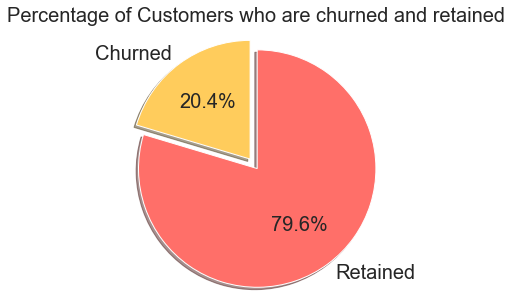

In [873]:
labels = 'Churned', 'Retained'

N_Churned = df.CustomerId[df['Exited']==1].count()
N_Retained = df.CustomerId[df['Exited']==0].count()

sizes = [N_Churned, N_Retained]
explode = (0, 0.1)
fig1, ax1 = plt.subplots(figsize=(5, 5))

ax1.pie(sizes, explode=explode, labels=labels, 
        autopct='%1.1f%%', shadow=True, startangle=90, textprops={'fontsize': 20},
       colors=['#ffcc5c','#ff6f69'])
ax1.axis('equal')
plt.title("Percentage of Customers who are churned and retained", size = 20)
plt.show()

<b> Churn Rate : (Users at beginning of the period - Users at end of the period)/Users at beginning of the period </b> <br>
Since we don't have time specific data, we are considering the data all together.
- Nearly 20% of the Customers have churned. 
- The ideal Churn rate is 5%

In [874]:
# Creating a Status variable for better graphical representation
df['Status']=np.where(df['Exited']==1, 'Churned', 'Retained')

In [875]:
alt.Chart(df).mark_bar().encode(x=alt.X("Gender", title=None), 
                                y=alt.Y('count(CustomerId)', 
                                        stack="normalize", 
                                        axis=alt.Axis(format='%', title='Percentage')),
                                color=alt.Color('Status',scale=alt.Scale(scheme='oranges')),
                                order=alt.Order('Status',sort='ascending'),
                                tooltip = 'count(CustomerId)'
                               ).properties(width=200)


alt.Chart(...)

- Churn Percentage in Females is 25%
- Churn Percentage in Males is 16%


In [876]:
alt.Chart(df, title='Gender-Wise Churn across Countries', height=250).mark_bar().encode(
    x=alt.X('Gender:N', title=None),
    y=alt.Y('count(CustomerId)', stack="normalize", axis=alt.Axis(format='%', title='Percentage')),
    color=alt.Color('Status',scale=alt.Scale(scheme='oranges')),
    order=alt.Order('Status',sort='ascending'),
    column='Geography:N',
    tooltip = 'count(CustomerId)').properties(width=100)

alt.Chart(...)

- The percentage of Customers who churn (both Females and Males) in Germany tend to be more than those of France and Spain.

In [877]:
alt.Chart(df, title='Gender-Wise Churn across Age Ranges', height=250).mark_bar().encode(
    alt.X('Gender:N', title=None),
    alt.Y('count(CustomerId)',
            stack="normalize",
            axis=alt.Axis(format='%', title='Percentage')),    
    alt.Column('Age:O', bin=True),
    color=alt.Color('Status:N', scale=alt.Scale(range=['#ffcc5c','#ff6f69'])),
    order=alt.Order('Status',sort='ascending'),
    tooltip = 'count(CustomerId)'
).properties(
    width=100  # width of one column facet
)

alt.Chart(...)

- Churn rates are higher for both Genders in Age Range of 40 - 80

In [878]:
df_Churn = df.loc[df['Exited']==1]
len(df_Churn)

2037

In [879]:
alt.Chart(df, title='Percentage of Customer Churn across Credit Score Ranges', height=250).mark_bar().encode(
    alt.X('CreditScore:Q', bin=True, title=None),
    alt.Y('count(CustomerId)',
            stack="normalize",
            axis=alt.Axis(format='%', title='Percentage')),        
    color=alt.Color('Status:N', scale=alt.Scale(range=['#ffcc5c','#ff6f69'])),
    order=alt.Order('Status',sort='ascending'),
    tooltip = 'count(CustomerId)'
).properties(
    width=300  
)

alt.Chart(...)

- Churn rates are higher when the credit score is less than 400 (a very less credibility)
- However the evidence can be substantiated with a larger dataset

- Churn rates are evenly distributed across various salary ranges

In [881]:
alt.Chart(df, title='Percentage of Customer Churn across Balance Ranges', height=250).mark_bar().encode(
    alt.X('Balance:Q', bin=True, title=None),
    alt.Y('count(CustomerId)',
            stack="normalize",
            axis=alt.Axis(format='%', title='Percentage')),        
    color=alt.Color('Status:N', scale=alt.Scale(range=['#ffcc5c','#ff6f69'])),
    order=alt.Order('Status',sort='ascending'),
    tooltip = 'count(CustomerId)'
).properties(
    width=300  # width of one column facet
)

alt.Chart(...)

- Churn rates are higher with people having higher bank balance
- However the evidence can be substantiated with a more data

In [882]:
alt.Chart(df, title='Gender-Wise Churn across the No. of products', height=250).mark_bar().encode(
    x=alt.X('Gender:N', title=None),
    y=alt.Y('count(CustomerId)', stack="normalize", axis=alt.Axis(format='%', title='Percentage')),
    color=alt.Color('Status',scale=alt.Scale(scheme='oranges')),
    order=alt.Order('Status',sort='ascending'),
    column='NumOfProducts:N',
    tooltip = 'count(CustomerId)').properties(width=100)

alt.Chart(...)

- Churn rates are higher in the order of Num of Products being 4, 3 and 1. 
- People who had invested in just 2 products churn very less
- With data on the Product details, we can substantiate the churn rates across specific products

In [885]:
alt.Chart(df_Churn, 
          title="Counts of Customers churned across Salary and Credit Score").mark_circle().encode(alt.X('CreditScore:Q', 
                                                                                                         bin=True),
                                                                                                   alt.Y('EstimatedSalary:Q', 
                                                                                                         bin=True),
                                                                                                   color="count()",
                                                                                                   tooltip = 'count(CustomerId)')

alt.Chart(...)

- The Customers who churned are more in the mid range of credit score, pertaining to the availablility of data
- However, the percentage of Churners are higher in lower credit score range

In [886]:
alt.Chart(df_Churn).mark_circle().encode(alt.X('Balance:Q', bin=True),
                                  alt.Y('NumOfProducts:Q'),
                                  color="count()")

alt.Chart(...)

- The Customers who churned are higher in a mid-range maintained balance, who have invested in one product.

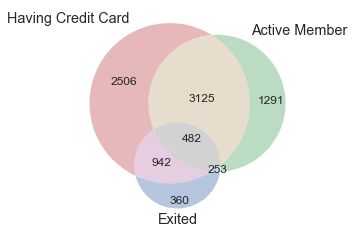

In [887]:
set1 = set(df.loc[df['HasCrCard']==1,'CustomerId'])
set2 = set(df.loc[df['IsActiveMember']==1,'CustomerId'])
set3 = set(df.loc[df['Exited']==1,'CustomerId'])

venn3([set1, set2, set3], ('Having Credit Card', 'Active Member', 'Exited'))

plt.show()

- We observe that 482 Customers churn inspite of being an Active member and availing the Bank's credit card.
- We need to analyze more on these Customers to know the reason for their Churn behaviour, probably on the usage of the credit card and the products they had invested
<br>
- 942 Customers who had availed credit card were not active over a period, and hence they tend to churn
- 253 Customers have churned inspite of being an active member but without availing a credit card

In [889]:
alt.Chart(df).mark_circle(size=60).encode(
    x='CreditScore',
    y='EstimatedSalary',
    color='Exited'
).interactive()

alt.Chart(...)

In [890]:
alt.Chart(df).mark_circle(size=60).encode(
    x='CreditScore',
    y='Tenure',
    color='Exited'
).interactive()

alt.Chart(...)

- The distribution of Customers who have churned and retained are evenly distributed across various features 
- A linear model of classifying the Class would not be feasible for the available data

### Outliers Analysis

In [891]:
num_cols = ['CreditScore','Balance','EstimatedSalary']

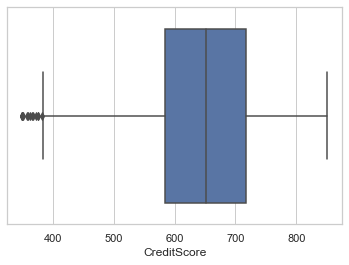

In [892]:
sns.set_theme(style="whitegrid")
ax = sns.boxplot(x=df["CreditScore"])

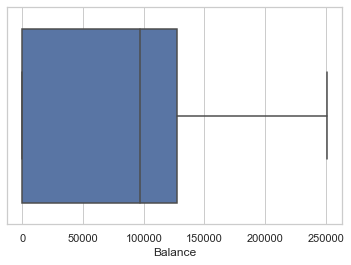

In [893]:
sns.set_theme(style="whitegrid")
ax = sns.boxplot(x=df["Balance"])

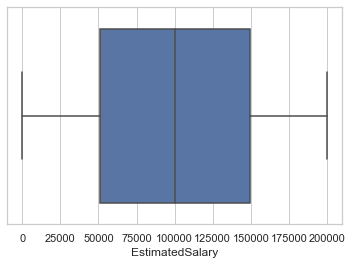

In [894]:
sns.set_theme(style="whitegrid")
ax = sns.boxplot(x=df["EstimatedSalary"])

In [895]:
outliers = df.copy()
initial = len(df.index)
Q1 = outliers['CreditScore'].quantile(0.05)
print(Q1)
Q3 = outliers['CreditScore'].quantile(0.95)
print(Q3)
IQR = Q3 - Q1
print(IQR)
outliers = outliers[(outliers['CreditScore'] <= Q1 - 1.5*IQR) & (outliers['CreditScore'] >= Q3 + 1.5*IQR)]

final = len(outliers.index)
print(final)
print(round((initial - final)/initial * 100, 2))

489.0
812.0
323.0
0
100.0


In [896]:
len(outliers)

0

No outliers are identified using the InterQuantile Range method. Hence we move to model building without removing outliers

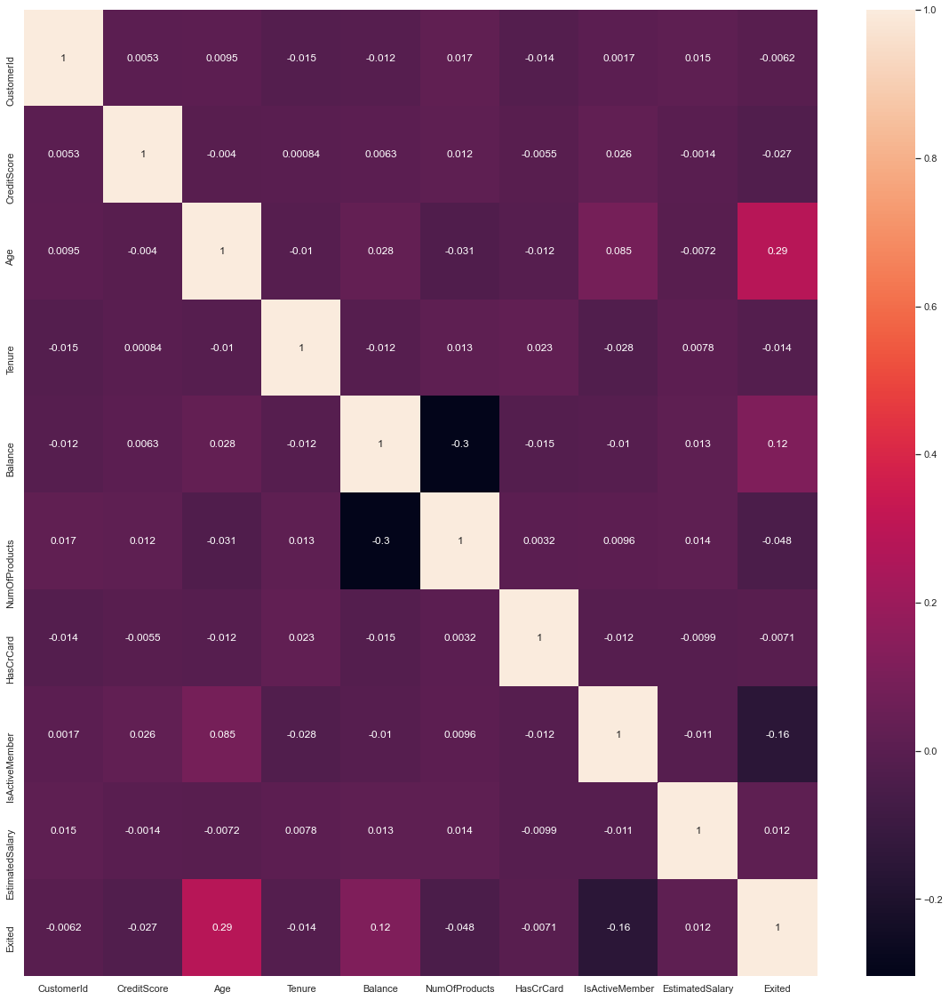

In [897]:
# sns.color_palette("viridis", as_cmap=True)
plt.figure(figsize = (20,20))
sns.heatmap(df.corr(), annot = True)
plt.show()

- There is no correlation between the numeric variables

In [898]:
#num_cols = X_train.select_dtypes(exclude='object').columns
num_cols = ['CreditScore', 'Age', 'Tenure', 'Balance', 'NumOfProducts', 'HasCrCard',
       'IsActiveMember', 'EstimatedSalary']

### Analysing the distribution of numeric variables

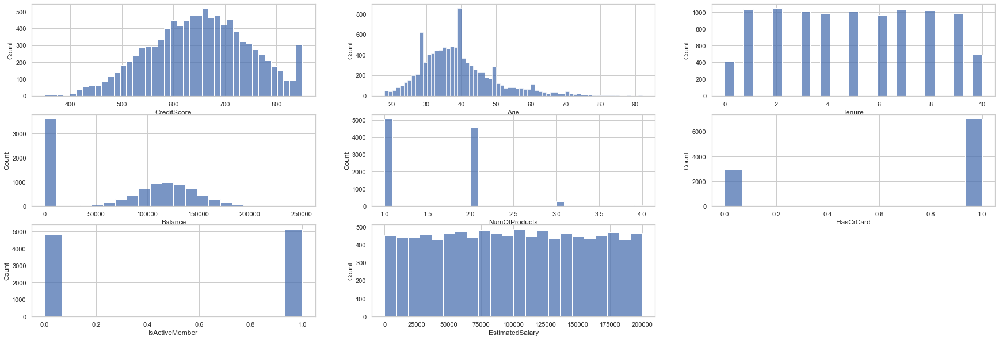

In [899]:
plt.figure(figsize=(30, 10))
i = 0
for col in num_cols:
    plt.subplot(3,3,i+1)
    sns.histplot(df[col],label='big')
    plt.xlabel(col)
    i = i + 1

plt.show()

In [900]:
cols = df.columns
cols

Index(['CustomerId', 'CreditScore', 'Geography', 'Gender', 'Age', 'Tenure',
       'Balance', 'NumOfProducts', 'HasCrCard', 'IsActiveMember',
       'EstimatedSalary', 'Exited', 'Status'],
      dtype='object')

In [901]:
# Copy of the Data Frame for Separate training model for Decision Tree without binning the features
bank = df.copy()

## Feature Engineering

### Age Binning

In [902]:
df['Age_bin'] = pd.cut(x=df['Age'], bins=[1, 40, 100], 
                            labels=['1-40', '40-100'], 
                            right=False)

In [903]:
df.Age_bin.value_counts()

1-40      5987
40-100    4013
Name: Age_bin, dtype: int64

In [904]:
df.drop('Age',axis=1,inplace=True)

### Credit Score Range binning

In [905]:
print(len(df[df['CreditScore']<561]))
print(len(df[(df['CreditScore']>=561) & (df['CreditScore']<721)]))
print(len(df[(df['CreditScore']>=721) & (df['CreditScore']<881)]))
print(len(df[(df['CreditScore']>=881) & (df['CreditScore']<961)]))

1876
5716
2408
0


In [906]:
df['CreditScore_bin'] = pd.cut(x=df['CreditScore'], bins=[0, 561, 721, 881, 961], 
                            labels=['0-560', '561-720', '721-880', '881-960'], 
                            right=False)

In [907]:
df.CreditScore_bin.value_counts()

561-720    5716
721-880    2408
0-560      1876
881-960       0
Name: CreditScore_bin, dtype: int64

In [908]:
df.drop('CreditScore',axis=1,inplace=True)

### Balance binning

In [909]:
print(len(df[df['Balance']<100000]))
print(len(df[(df['Balance']>=100000) & (df['Balance']<200000)]))
print(len(df[(df['Balance']>=200000) & (df['Balance']<300000)]))

5201
4765
34


In [910]:
df['Balance_bin'] = pd.cut(x=df['Balance'], bins=[0, 100000, 200000, 300000], 
                            labels=['0-100K', '100K-200K', '200K-300K'], 
                            right=False)

In [911]:
df.Balance_bin.value_counts()

0-100K       5201
100K-200K    4765
200K-300K      34
Name: Balance_bin, dtype: int64

In [912]:
df.drop('Balance',axis=1,inplace=True)

In [913]:
df.columns

Index(['CustomerId', 'Geography', 'Gender', 'Tenure', 'NumOfProducts',
       'HasCrCard', 'IsActiveMember', 'EstimatedSalary', 'Exited', 'Status',
       'Age_bin', 'CreditScore_bin', 'Balance_bin'],
      dtype='object')

## Data Preparation

### Dummy Variables For Decision Tree

In [914]:
cat_cols = ['Geography', 'Gender', 'NumOfProducts']

In [915]:
# Creating the dummy variables for the categorical columns
for col in cat_cols:   
    bank_dummy = pd.get_dummies(bank[col], prefix = col, drop_first = False)
    bank = pd.concat([bank, bank_dummy], axis = 1)
    bank.drop(col, axis = 1, inplace = True)    
bank.head()

,CustomerId,CreditScore,Age,Tenure,Balance,HasCrCard,IsActiveMember,EstimatedSalary,Exited,Status,Geography_France,Geography_Germany,Geography_Spain,Gender_Female,Gender_Male,NumOfProducts_1,NumOfProducts_2,NumOfProducts_3,NumOfProducts_4
0,15634602,619,42,2,0.00,1,1,101348.88,1,Churned,1,0,0,1,0,1,0,0,0
1,15647311,608,41,1,83807.86,0,1,112542.58,0,Retained,0,0,1,1,0,1,0,0,0
2,15619304,502,42,8,159660.80,1,0,113931.57,1,Churned,1,0,0,1,0,0,0,1,0
3,15701354,699,39,1,0.00,0,0,93826.63,0,Retained,1,0,0,1,0,0,1,0,0
4,15737888,850,43,2,125510.82,1,1,79084.10,0,Retained,0,0,1,1,0,1,0,0,0


In [916]:
bank.columns

Index(['CustomerId', 'CreditScore', 'Age', 'Tenure', 'Balance', 'HasCrCard',
       'IsActiveMember', 'EstimatedSalary', 'Exited', 'Status',
       'Geography_France', 'Geography_Germany', 'Geography_Spain',
       'Gender_Female', 'Gender_Male', 'NumOfProducts_1', 'NumOfProducts_2',
       'NumOfProducts_3', 'NumOfProducts_4'],
      dtype='object')

In [917]:
drop_cols = ['Geography_Spain', 'Gender_Male', 'NumOfProducts_2']

In [918]:
bank.drop(drop_cols, axis=1, inplace=True)

In [919]:
bank.columns

Index(['CustomerId', 'CreditScore', 'Age', 'Tenure', 'Balance', 'HasCrCard',
       'IsActiveMember', 'EstimatedSalary', 'Exited', 'Status',
       'Geography_France', 'Geography_Germany', 'Gender_Female',
       'NumOfProducts_1', 'NumOfProducts_3', 'NumOfProducts_4'],
      dtype='object')

### Dummy variables for SVC and SGD

In [920]:
cat_cols = ['Geography','Gender','Age_bin','NumOfProducts', 'CreditScore_bin', 'Balance_bin']

In [921]:
# Creating the dummy variables for the categorical columns
for col in cat_cols:   
    df_dummy = pd.get_dummies(df[col], prefix = col, drop_first = False)
    df = pd.concat([df, df_dummy], axis = 1)
    df.drop(col, axis = 1, inplace = True)    
df.head()

,CustomerId,Tenure,HasCrCard,IsActiveMember,EstimatedSalary,Exited,Status,Geography_France,Geography_Germany,Geography_Spain,...,NumOfProducts_2,NumOfProducts_3,NumOfProducts_4,CreditScore_bin_0-560,CreditScore_bin_561-720,CreditScore_bin_721-880,CreditScore_bin_881-960,Balance_bin_0-100K,Balance_bin_100K-200K,Balance_bin_200K-300K
0,15634602,2,1,1,101348.88,1,Churned,1,0,0,...,0,0,0,0,1,0,0,1,0,0
1,15647311,1,0,1,112542.58,0,Retained,0,0,1,...,0,0,0,0,1,0,0,1,0,0
2,15619304,8,1,0,113931.57,1,Churned,1,0,0,...,0,1,0,1,0,0,0,0,1,0
3,15701354,1,0,0,93826.63,0,Retained,1,0,0,...,1,0,0,0,1,0,0,1,0,0
4,15737888,2,1,1,79084.10,0,Retained,0,0,1,...,0,0,0,0,0,1,0,0,1,0


In [922]:
df.columns

Index(['CustomerId', 'Tenure', 'HasCrCard', 'IsActiveMember',
       'EstimatedSalary', 'Exited', 'Status', 'Geography_France',
       'Geography_Germany', 'Geography_Spain', 'Gender_Female', 'Gender_Male',
       'Age_bin_1-40', 'Age_bin_40-100', 'NumOfProducts_1', 'NumOfProducts_2',
       'NumOfProducts_3', 'NumOfProducts_4', 'CreditScore_bin_0-560',
       'CreditScore_bin_561-720', 'CreditScore_bin_721-880',
       'CreditScore_bin_881-960', 'Balance_bin_0-100K',
       'Balance_bin_100K-200K', 'Balance_bin_200K-300K'],
      dtype='object')

In [923]:
drop_cols = ['Geography_Spain', 'Gender_Male', 'Age_bin_1-40', 
             'NumOfProducts_2','CreditScore_bin_881-960','Balance_bin_200K-300K']

In [924]:
df.drop(drop_cols, axis=1, inplace=True)

In [925]:
X = df.drop(['CustomerId','Exited','Status'],axis=1)
y = df['Exited']

In [926]:
X_dt = bank.drop(['CustomerId','Exited','Status'],axis=1)
y_dt = bank['Exited']

In [927]:
X_dt.columns

Index(['CreditScore', 'Age', 'Tenure', 'Balance', 'HasCrCard',
       'IsActiveMember', 'EstimatedSalary', 'Geography_France',
       'Geography_Germany', 'Gender_Female', 'NumOfProducts_1',
       'NumOfProducts_3', 'NumOfProducts_4'],
      dtype='object')

In [928]:
X.columns

Index(['Tenure', 'HasCrCard', 'IsActiveMember', 'EstimatedSalary',
       'Geography_France', 'Geography_Germany', 'Gender_Female',
       'Age_bin_40-100', 'NumOfProducts_1', 'NumOfProducts_3',
       'NumOfProducts_4', 'CreditScore_bin_0-560', 'CreditScore_bin_561-720',
       'CreditScore_bin_721-880', 'Balance_bin_0-100K',
       'Balance_bin_100K-200K'],
      dtype='object')

In [929]:
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.7, test_size=0.3, stratify=y, random_state=24)

In [930]:
X_train_dt, X_test_dt, y_train_dt, y_test_dt = train_test_split(X_dt, y_dt, train_size=0.7, test_size=0.3, stratify=y, random_state=24)

In [931]:
print('Percentage of Churned Customers in the original dataset: ' + str(round((np.sum(y)/len(df.index)) * 100, 3)))
print('Percentage of Churned Customers in the train dataset: ' + str(round((np.sum(y_train)/len(y_train))*100, 3)))
print('Percentage of Churned Customers in the test dataset: ' + str(round((np.sum(y_test)/len(y_test))*100, 3)))

Percentage of Churned Customers in the original dataset: 20.37
Percentage of Churned Customers in the train dataset: 20.371
Percentage of Churned Customers in the test dataset: 20.367


- The classes are evenly distributed in Train and Test Data after splitting by stratified methid

## Data Pre-Processing

### Power Transformation

In [932]:
pt = PowerTransformer(method = 'yeo-johnson', copy=False)
X_train_pt = pt.fit_transform(X_train)    
X_test_pt = pt.transform(X_test)

## Scaling

In [933]:
scaler = StandardScaler()
X_train_s = scaler.fit_transform(X_train_pt)
X_test_s = scaler.transform(X_test_pt)

In [934]:
X_train_s = pd.DataFrame(X_train_s, columns = X_train.columns, index=X_train.index)
X_test_s = pd.DataFrame(X_test_s, columns = X_test.columns, index=X_test.index)

### Common functions for model evaluation

In [935]:
def ModelMetrics(y_test, y_test_pred):   

    # Printing classification report
    print("********* Classification Report *********")
    print(classification_report(y_test, y_test_pred))

    # Printing confusion matrix and accuracy
    print("**** Confusion Matrix ****")
    confusion_mat = confusion_matrix(y_test, y_test_pred)
    print(confusion_mat)
    print('\n')
    
    TP = confusion_mat[1,1] # true positive 
    TN = confusion_mat[0,0] # true negatives
    FP = confusion_mat[0,1] # false positives
    FN = confusion_mat[1,0] # false negatives
    
    print("Accuracy Score: " + str(round(accuracy_score(y_test, y_test_pred), 4)))
    print("Sensitivity: " + str(round(TP/float(TP+FN), 4)))
    print("Specificity: " + str(round(TN/float(TN+FP), 4)))
    print("False Positive Rate: " + str(round(FP/float(TN+FP), 4)))
    print("Positive Predictive Value: " + str(round(TP/float(TP+FP), 4)))
    print("Negative Predictive Value: " + str(round(TN/float(TN+FN), 4)))
    precision = round(TP/float(TP+FP), 4)
    print("Precision: " + str(precision))
    recall = round(TP/float(TP+FN), 4)
    print("Recall: " + str(recall))
    F1 = round(2 * (precision*recall)/(precision+recall), 4)
    print("F1 Score: " + str(F1))

In [936]:
def draw_roc( actual, probs ):
    fpr, tpr, thresholds = roc_curve( actual, probs,
                                              drop_intermediate = False )
    auc_score = roc_auc_score( actual, probs )
    plt.figure(figsize=(5, 5))
    plt.plot( fpr, tpr, label='ROC curve (area = %0.2f)' % auc_score )
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate or [1 - True Negative Rate]')
    plt.ylabel('True Positive Rate')
    plt.title('ROC Curve')
    plt.legend(loc="lower right")
    plt.show()

    return None

# Models

## 1. Decision Tree 

In [937]:
# specify number of folds for Stratified k-fold CV
folds = StratifiedKFold(n_splits = 3, shuffle = True, random_state = 48) 

# defining parameter range
param_grid = {'max_depth': range(1, 40), 
              'min_samples_leaf': range(5, 200, 20),
              'min_samples_split': range(5, 200, 20),
              'class_weight' : [{1:0.8, 0:0.2}, {1:0.7, 0:0.3}] } 

DTree = DecisionTreeClassifier(criterion = "gini", random_state = 48)

random = RandomizedSearchCV(estimator=DTree, cv=folds,
                            param_distributions=param_grid, 
                            scoring='roc_auc', 
                            verbose=1, n_jobs=-1, 
                            n_iter=10) 

random_result = random.fit(X_train_dt, y_train_dt) 
print('Best Score: ', random_result.best_score_) 
print('Best Params: ', random_result.best_params_) 

Fitting 3 folds for each of 10 candidates, totalling 30 fits
Best Score:  0.8145153034869832
Best Params:  {'min_samples_split': 125, 'min_samples_leaf': 45, 'max_depth': 29, 'class_weight': {1: 0.7, 0: 0.3}}


********* Classification Report *********
              precision    recall  f1-score   support

           0       0.91      0.86      0.89      5574
           1       0.56      0.67      0.61      1426

    accuracy                           0.82      7000
   macro avg       0.73      0.77      0.75      7000
weighted avg       0.84      0.82      0.83      7000

**** Confusion Matrix ****
[[4812  762]
 [ 474  952]]


Accuracy Score: 0.8234
Sensitivity: 0.6676
Specificity: 0.8633
False Positive Rate: 0.1367
Positive Predictive Value: 0.5554
Negative Predictive Value: 0.9103
Precision: 0.5554
Recall: 0.6676
F1 Score: 0.6064
None


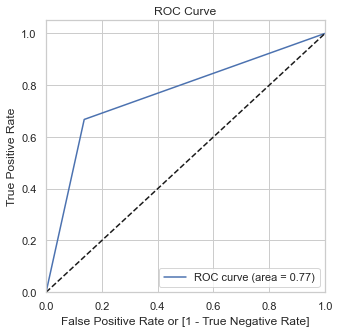

None


In [938]:
DTree = DecisionTreeClassifier(criterion = "gini", random_state = 48,
                              min_samples_split=125, min_samples_leaf=45, max_depth=29, 
                               class_weight= {1: 0.7, 0: 0.3})
DTree.fit(X_train_dt, y_train_dt)
y_train_pred = DTree.predict(X_train_dt)
print(ModelMetrics(y_train_dt, y_train_pred))
print(draw_roc(y_train_dt, y_train_pred))

********* Classification Report *********
              precision    recall  f1-score   support

           0       0.90      0.85      0.88      2389
           1       0.52      0.64      0.57       611

    accuracy                           0.81      3000
   macro avg       0.71      0.74      0.73      3000
weighted avg       0.82      0.81      0.81      3000

**** Confusion Matrix ****
[[2036  353]
 [ 223  388]]


Accuracy Score: 0.808
Sensitivity: 0.635
Specificity: 0.8522
False Positive Rate: 0.1478
Positive Predictive Value: 0.5236
Negative Predictive Value: 0.9013
Precision: 0.5236
Recall: 0.635
F1 Score: 0.5739
None


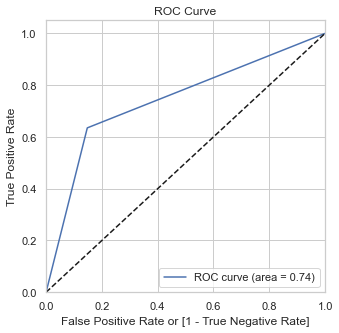

None


In [939]:
y_test_pred = DTree.predict(X_test_dt)
  
# print classification report
print(ModelMetrics(y_test_dt, y_test_pred))
print(draw_roc(y_test_dt, y_test_pred))

In [940]:
feature_importances = pd.DataFrame(DTree.feature_importances_,
                                   index = X_train_dt.columns,
                                   columns=['importance']).sort_values('importance',ascending=False)

feature_importances

,importance
Age,0.469217
Balance,0.118733
IsActiveMember,0.109015
NumOfProducts_1,0.107261
NumOfProducts_3,0.089794
Geography_Germany,0.060047
CreditScore,0.018314
EstimatedSalary,0.013872
Gender_Female,0.010179
Tenure,0.003220


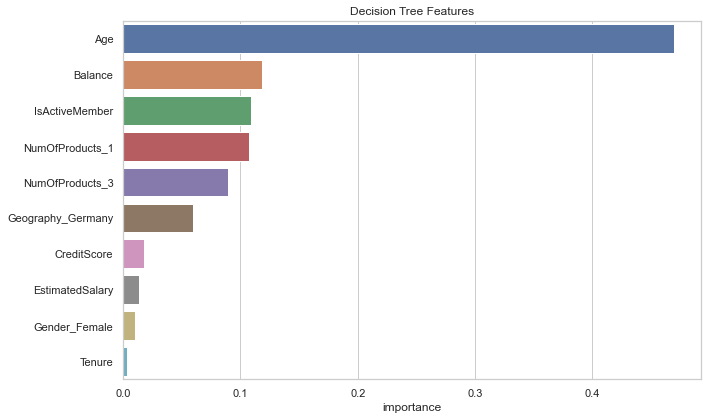

In [941]:
# Plotting the features
plt.figure(figsize=(10, 6))

feature_importances = feature_importances[:10]
sns.barplot(x = "importance",
            y = feature_importances.index,
            data = feature_importances.sort_values(by = "importance", ascending = False))

plt.title('Decision Tree Features')
plt.tight_layout()
plt.show()

### SVM

### SVC on SMOTE balanced Data

In [942]:
# specify number of folds for Stratified k-fold CV
folds = StratifiedKFold(n_splits = 3, shuffle = True, random_state = 48) 

# defining parameter range
param_grid = {'C': [0.1, 1, 10, 100], 
              'gamma': [1, 0.1, 0.01, 0.001],
              'class_weight' : [{1:0.8, 0:0.2}, {1:0.7, 0:0.3}] 
              } 

svc = SVC(kernel='rbf', random_state=48)

random = RandomizedSearchCV(estimator=svc, cv=folds,
                            param_distributions=param_grid, 
                            scoring='roc_auc', 
                            verbose=1, n_jobs=-1, 
                            n_iter=10) 

random_result = random.fit(X_train_s, y_train) 

print('Best Score: ', random_result.best_score_) 
print('Best Params: ', random_result.best_params_) 

Fitting 3 folds for each of 10 candidates, totalling 30 fits
Best Score:  0.8364667271928315
Best Params:  {'gamma': 0.001, 'class_weight': {1: 0.8, 0: 0.2}, 'C': 100}


********* Classification Report *********
              precision    recall  f1-score   support

           0       0.92      0.78      0.85      5574
           1       0.46      0.73      0.57      1426

    accuracy                           0.77      7000
   macro avg       0.69      0.76      0.71      7000
weighted avg       0.83      0.77      0.79      7000

**** Confusion Matrix ****
[[4363 1211]
 [ 382 1044]]


Accuracy Score: 0.7724
Sensitivity: 0.7321
Specificity: 0.7827
False Positive Rate: 0.2173
Positive Predictive Value: 0.463
Negative Predictive Value: 0.9195
Precision: 0.463
Recall: 0.7321
F1 Score: 0.5673
None


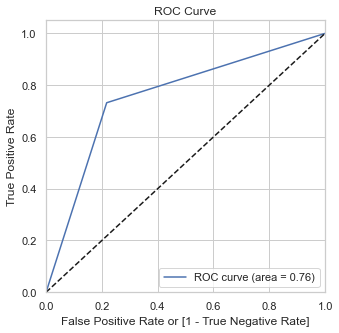

None


In [943]:
Model = SVC(kernel='rbf', C=100, class_weight={1: 0.8, 0: 0.2}, gamma=0.001, random_state=48)

Model.fit(X_train_s, y_train)

y_train_pred = Model.predict(X_train_s)
  
# print classification report
print(ModelMetrics(y_train, y_train_pred))
print(draw_roc(y_train, y_train_pred))

********* Classification Report *********
              precision    recall  f1-score   support

           0       0.92      0.79      0.85      2389
           1       0.47      0.74      0.58       611

    accuracy                           0.78      3000
   macro avg       0.70      0.76      0.71      3000
weighted avg       0.83      0.78      0.79      3000

**** Confusion Matrix ****
[[1885  504]
 [ 161  450]]


Accuracy Score: 0.7783
Sensitivity: 0.7365
Specificity: 0.789
False Positive Rate: 0.211
Positive Predictive Value: 0.4717
Negative Predictive Value: 0.9213
Precision: 0.4717
Recall: 0.7365
F1 Score: 0.5751
None


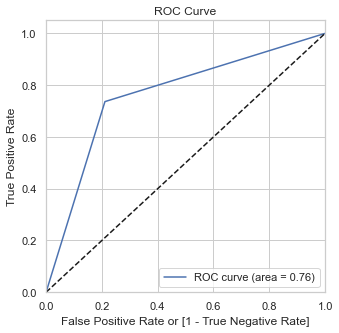

None


In [944]:
y_test_pred = Model.predict(X_test_s)
  
# print classification report
print(ModelMetrics(y_test, y_test_pred))
print(draw_roc(y_test, y_test_pred))

## SGD

In [958]:
penalty = ['l1', 'l2', 'elasticnet'] 
loss = ['hinge', 'log']
alpha = [0.0001, 0.001, 0.01, 0.1, 1, 10, 100, 1000] 
learning_rate = ['constant', 'optimal', 'invscaling', 'adaptive'] 
class_weight = [{1:0.8, 0:0.2}, {1:0.7, 0:0.3}] 
eta0 = [1, 10, 100] 

param_distributions = dict(penalty=penalty, alpha=alpha,
                           loss=loss, learning_rate=learning_rate, 
                           class_weight=class_weight, eta0=eta0) 

sgd = SGDClassifier(max_iter=20, random_state=48) 

random = RandomizedSearchCV(estimator=sgd, 
                            param_distributions=param_distributions, 
                            scoring='roc_auc', 
                            verbose=1, n_jobs=-1, 
                            n_iter=10) 

random_result = random.fit(X_train_s, y_train) 
print('Best Score: ', random_result.best_score_) 
print('Best Params: ', random_result.best_params_) 

Fitting 5 folds for each of 10 candidates, totalling 50 fits
Best Score:  0.8237248533111506
Best Params:  {'penalty': 'l2', 'loss': 'log', 'learning_rate': 'invscaling', 'eta0': 10, 'class_weight': {1: 0.8, 0: 0.2}, 'alpha': 0.01}


In [959]:
SGD = SGDClassifier(loss="log", penalty="l2", max_iter=20,
                    learning_rate='invscaling', 
                    eta0=10, class_weight= {1: 0.8, 0: 0.2}, alpha= 0.01,
                   random_state=48) 

In [960]:
SGD.fit(X_train_s, y_train) 
y_train_pred = SGD.predict(X_train_s)
ModelMetrics(y_train, y_train_pred)

********* Classification Report *********
              precision    recall  f1-score   support

           0       0.93      0.73      0.82      5574
           1       0.42      0.77      0.55      1426

    accuracy                           0.74      7000
   macro avg       0.67      0.75      0.68      7000
weighted avg       0.82      0.74      0.76      7000

**** Confusion Matrix ****
[[4067 1507]
 [ 323 1103]]


Accuracy Score: 0.7386
Sensitivity: 0.7735
Specificity: 0.7296
False Positive Rate: 0.2704
Positive Predictive Value: 0.4226
Negative Predictive Value: 0.9264
Precision: 0.4226
Recall: 0.7735
F1 Score: 0.5466


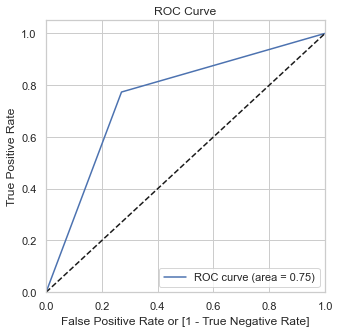

In [961]:
draw_roc(y_train, y_train_pred)

********* Classification Report *********
              precision    recall  f1-score   support

           0       0.93      0.73      0.82      2389
           1       0.43      0.78      0.55       611

    accuracy                           0.74      3000
   macro avg       0.68      0.76      0.68      3000
weighted avg       0.83      0.74      0.76      3000

**** Confusion Matrix ****
[[1744  645]
 [ 133  478]]


Accuracy Score: 0.7407
Sensitivity: 0.7823
Specificity: 0.73
False Positive Rate: 0.27
Positive Predictive Value: 0.4256
Negative Predictive Value: 0.9291
Precision: 0.4256
Recall: 0.7823
F1 Score: 0.5513


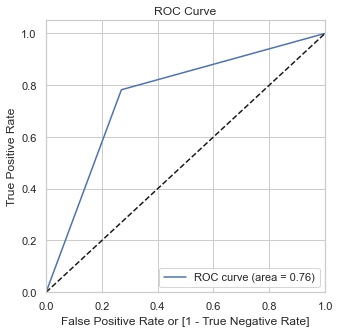

In [962]:
y_test_pred = SGD.predict(X_test_s)
ModelMetrics(y_test, y_test_pred)
draw_roc(y_test, y_test_pred)

|  | Decision Tree | SVC | SGD | 
| --- | --- | --- | --- |
| AUC-ROC | 0.74 | 0.76 | 0.76 |
| Sensitivity | 0.64 | 0.74 | 0.78 |
| Precision | 0.52 | 0.47 | 0.42 |


### Features of Importance based on Decision Tree 

| Features | Importance Factor |
| --- | --- |
| Age | 0.469217 |
| Balance | 0.118733 |
| IsActiveMember | 0.109015 |
| NumOfProducts_1 | 0.107261 |
| NumOfProducts_3 | 0.089794 |
| Geography_German | 0.060047 |
| CreditScore | 0.018314 |
| EstimatedSalary | 0.013872 |
| Gender_Female | 0.010179 |
| Tenure | 0.003220 |

According to the algorithm of Decision Tree, the features that contribute to the churn in the order of precedence <br> 
1. Age, being the dominant predictor
2. Balance maintained by the Customer
3. Customers being Active or Not
4. Customers who have invested in one product 
5. Customers who have invested in three products
6. Customers based out of Germany
7. Customers maintaining a low credit score
8. Estimated Salary of the Customer
9. Gender - Females tend to churn more than Males
10. Tenure contributing to a very small extent

### Choice of Model:
We would go by Stochastic Gradient Descent Model, 

| Actual/Predicted | Non-Churn | Churn |
| --- | --- | --- |
| Non-Churn | 1744 | 645 |
| Churn | 133 | 478 |

- 478 Customers out of 611 Customers are identified correctly, leading to a sensitivity of 78%
- 645 Customers out of 2389 Customers are identified incorrectly, leading to a low precision of 42%



- As per the business overview, the precision precedes importance as identifying the right churn is of priority.


We can arrive at a better model based on further analysis of <br>
- The various products offered by the bank
- Financial need of people more than 40 years of age
- Financial need of Female Customers
- Finance behaviour and patterns of Customers from Germany
- And a larger Data Set